# Метрика для оценки разницы между спектрограммами

In [1]:
import sys
sys.path.append('..')

from functools import reduce

import numpy as np
from scipy import signal

from seismicpro.batchflow import Dataset
from seismicpro.src import SeismicBatch, FieldIndex, seismic_plot

from utils import get_cv, draw_modifications_dist

### Процедура получения метрики

**Расстояние между двумя спектрограммами** с равным количеством трасс и отсчетов будем вычислять по следующей процедуре

* Выбрать область из 10% трасс с наименьшим офсетом, ограничить вычисления только в этой области
* Получить спектральную плотность мощности с помощью оконного преобразования Фурье для каждой трассы для обеих спектрограмм
* Для соответствующих значений сдвигов окна по времени и соответсвующих трасс вычислить разницу спектров в разных спектрограммах по формуле
$$
Dist(A_1, A_2) = \sum_{f}\left|{A_{1}[f]-A_{2}[f]}\right|
$$
* Усреднить полученные значения по всем трассам и всем сдвигам окна по времени

![Seismogram difference metrics](Seismogram_difference_metrics.png)

# Демонстрация работы на нормальном шуме 

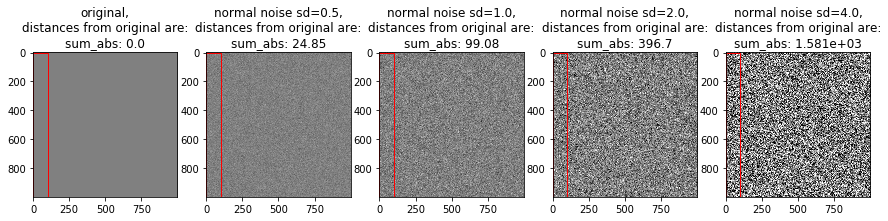

In [3]:
origin_shape = (1000, 1000)
origin = np.zeros(shape=origin_shape)
modifications = [(origin, "original")]
for i in range(1,5):
    mod = origin + np.random.normal(scale=2**i/4, size=origin_shape)
    modifications.append((mod, "normal noise sd={}".format(2**i/4)))
                         
draw_modifications_dist(modifications, vmin=-6, vmax=6, fontsize=12)    

# Сравнение искуственно зашумленных спектрограмм 

## Исходные данные

In [3]:
raw = np.load('raw_1.npy')
lift = np.load('lift_1.npy')
out = np.load('out_1.npy')
att = np.load('att_1.npy')

att = 1-att

cv = get_cv([raw])

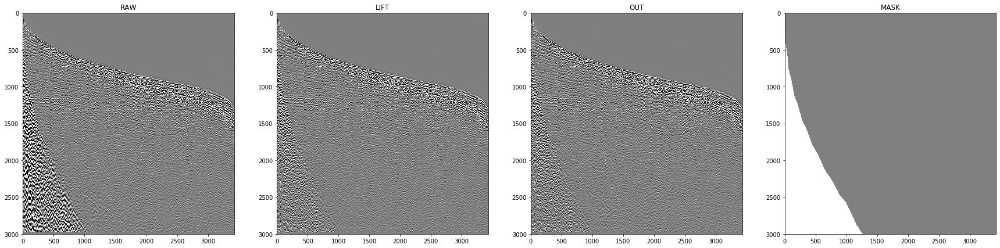

In [4]:
seismic_plot([raw, lift, out, att], figsize=(30, 7), names=['RAW', 'LIFT', 'OUT', 'MASK'], cmap='gray', vmin=-cv, vmax=cv)

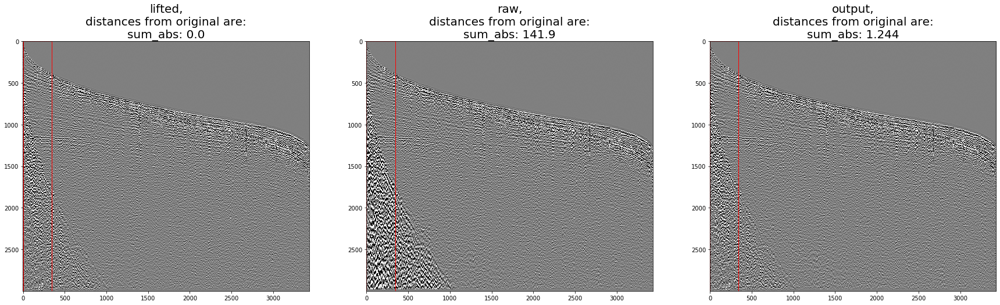

In [5]:
modifications = [(lift, "lifted"), (raw, "raw"), (out, "output")]

draw_modifications_dist(modifications, vmin=-cv, vmax=cv, figsize=(30, 10))    

## Шум в виде разницы между исходными и очищенными данными 

### Процедура получения
* Получить разницу между исходными и очищенными данными, удалить в ней все данные вне области поверхностной волны
* Составить синтетическую спектрограмму добавляя полученный шум к очищенным данным

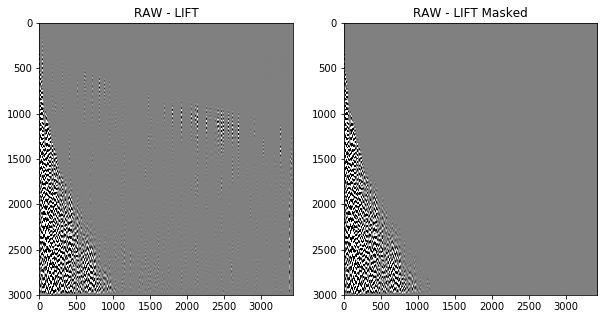

In [6]:
diff = raw - lift
diff_m = diff * att

seismic_plot([diff, diff_m], figsize=(10, 5), names=['RAW - LIFT', 'RAW - LIFT Masked'], cmap='gray', vmin=-cv, vmax=cv)

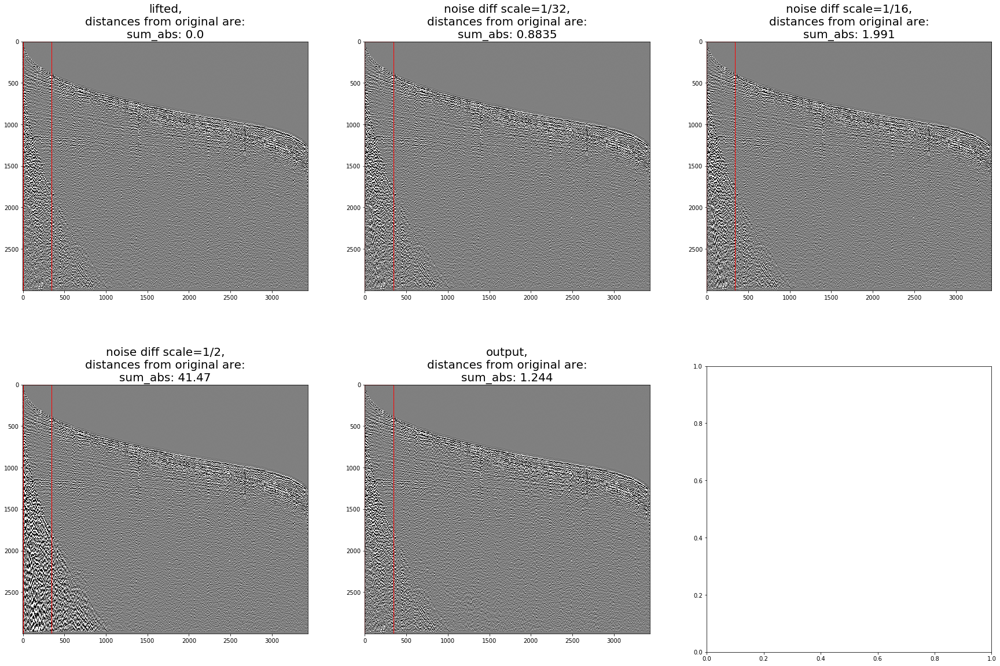

In [7]:
modifications = [(lift, "lifted")]

for scale in (32, 16, 2):
    mod = lift + diff_m / scale
    modifications.append((mod, "noise diff scale=1/{}".format(scale)))
    
modifications.append((out, "output"))

draw_modifications_dist(modifications, vmin=-cv, vmax=cv, figsize=(30, 20), n_cols=3)    

## Нормальный шум в области поверхностной волны

### Процедура получения
* Составить синтетическую спектрограмму, добавляя нормальный шум к очищенным данным только в области поверхностной волны

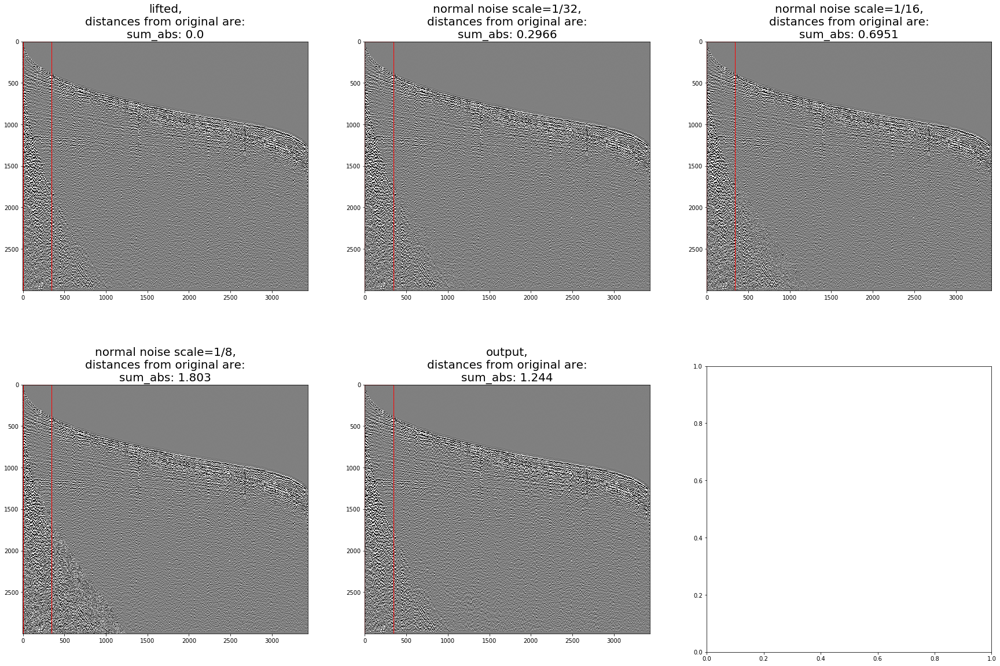

In [8]:
modifications = [(lift, "lifted")]

for scale in (32, 16, 8):
    mod = lift + np.random.normal(scale=1/scale, size=raw.shape) * att
    modifications.append((mod, "normal noise scale=1/{}".format(scale)))
    
modifications.append((out, "output"))

draw_modifications_dist(modifications, vmin=-cv, vmax=cv, figsize=(30, 20), n_cols=3)    

## Нормальный шум в спектре

### Процедура получения
* Получить оконное преобразование Фурье от очищенной вручную спектрограммы (Образец)
* Добавить в него нормальный шум
* Восстановить спектрограмму из зашумленного спектра (Шум)
* Составить синтетическую спектрограмму по правилу: в области поверхностнй волны использовать Шум, вне этой обрасти использовать Образец

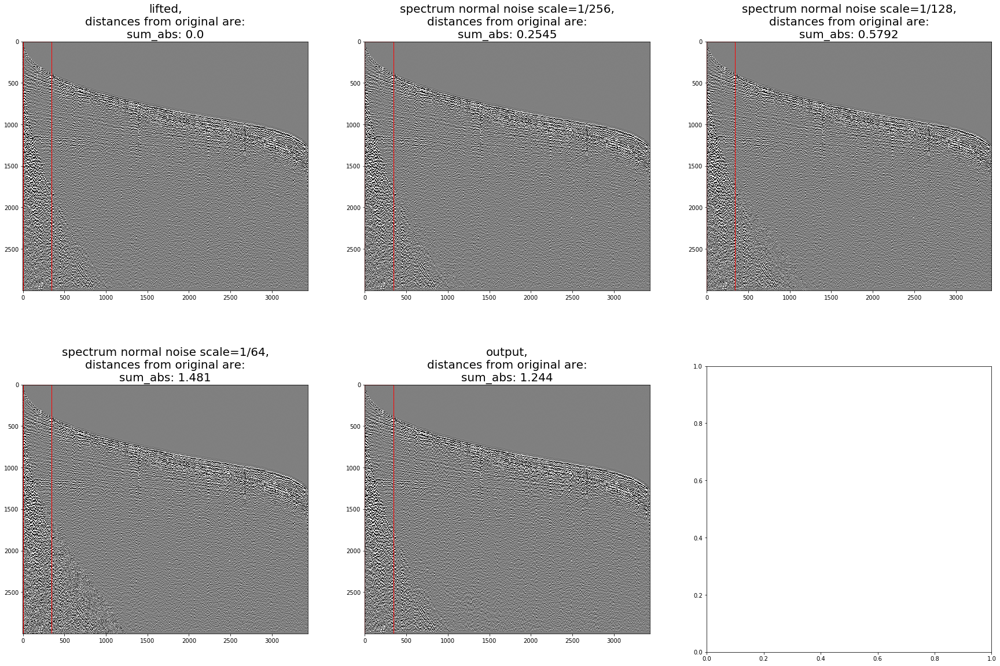

In [9]:
kwargs = dict(nperseg=100, noverlap=None, window=('tukey', 0.25))
f, t, Zxx = signal.stft(lift, **kwargs)

modifications = [(lift, "lifted")]
for scale in (256, 128, 64):  
    Zxx_n = Zxx + np.random.normal(scale=1/scale, size=Zxx.shape)
    _, lift_restored = signal.istft(Zxx_n, **kwargs)
    lift_restored = lift * (1 - att) + lift_restored * att
    modifications.append((lift_restored, 'spectrum normal noise scale=1/{}'.format(scale)))
    
modifications.append((out, "output"))

draw_modifications_dist(modifications, vmin=-cv, vmax=cv, figsize=(30, 20), n_cols=3)

## Равномерный шум в спектре

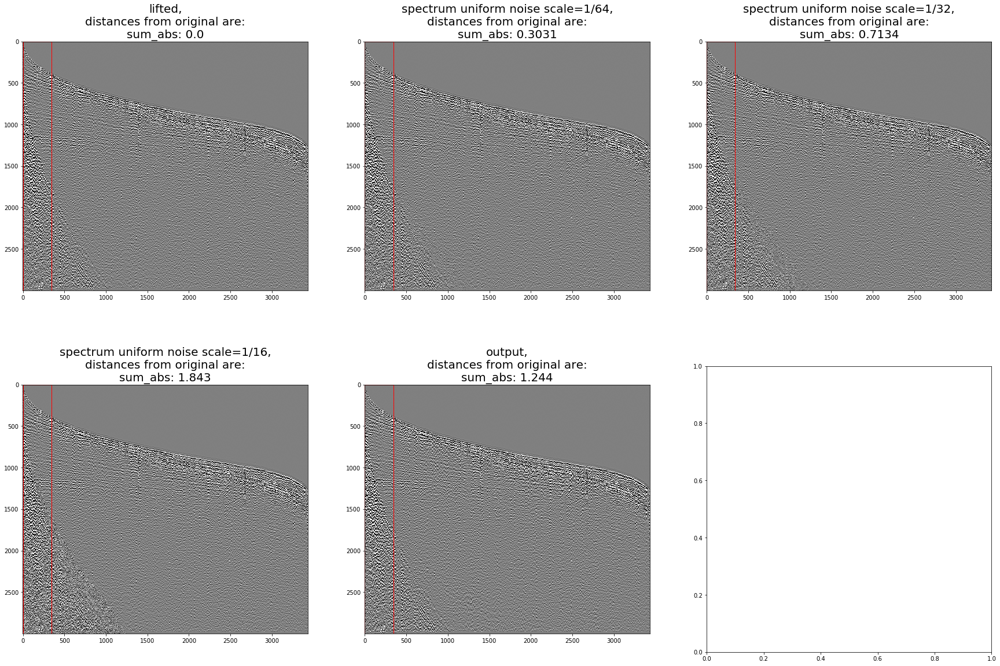

In [10]:
modifications = [(lift, "lifted")]
for scale in (64, 32, 16):  
    Zxx_n = Zxx + 1/scale * np.random.uniform(size=Zxx.shape)
    _, lift_restored = signal.istft(Zxx_n, **kwargs)
    lift_restored = lift * (1 - att) + lift_restored * att
    modifications.append((lift_restored, 'spectrum uniform noise scale=1/{}'.format(scale)))
    
modifications.append((out, "output"))

draw_modifications_dist(modifications, vmin=-cv, vmax=cv, figsize=(30, 20), n_cols=3)

## Нормальный шум в спектре, другие параметры оконного преобразования

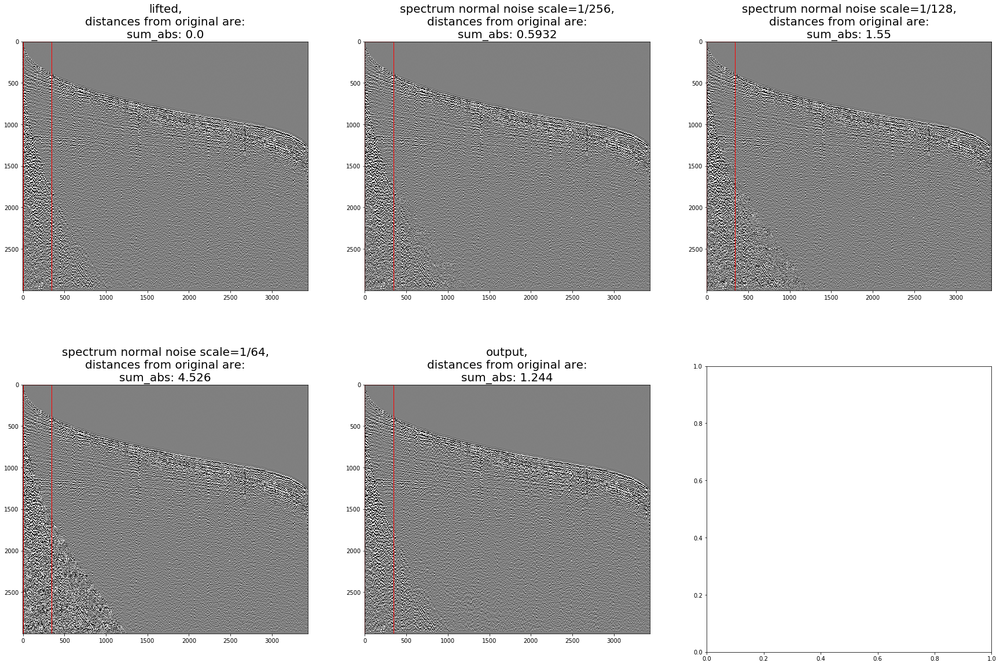

In [11]:
kwargs = dict(window='hann', nperseg=300, noverlap=100)
f, t, Zxx = signal.stft(lift, **kwargs)

modifications = [(lift, "lifted")]
for scale in (256, 128, 64):  
    Zxx_n = Zxx + np.random.normal(scale=1/scale, size=Zxx.shape)
    _, lift_restored = signal.istft(Zxx_n, **kwargs)
    lift_restored = lift * (1 - att) + lift_restored * att
    modifications.append((lift_restored, 'spectrum normal noise scale=1/{}'.format(scale)))
    
modifications.append((out, "output"))

draw_modifications_dist(modifications, vmin=-cv, vmax=cv, figsize=(30, 20), n_cols=3)

## Равномерный шум в спектре, другие параметры оконного преобразования 

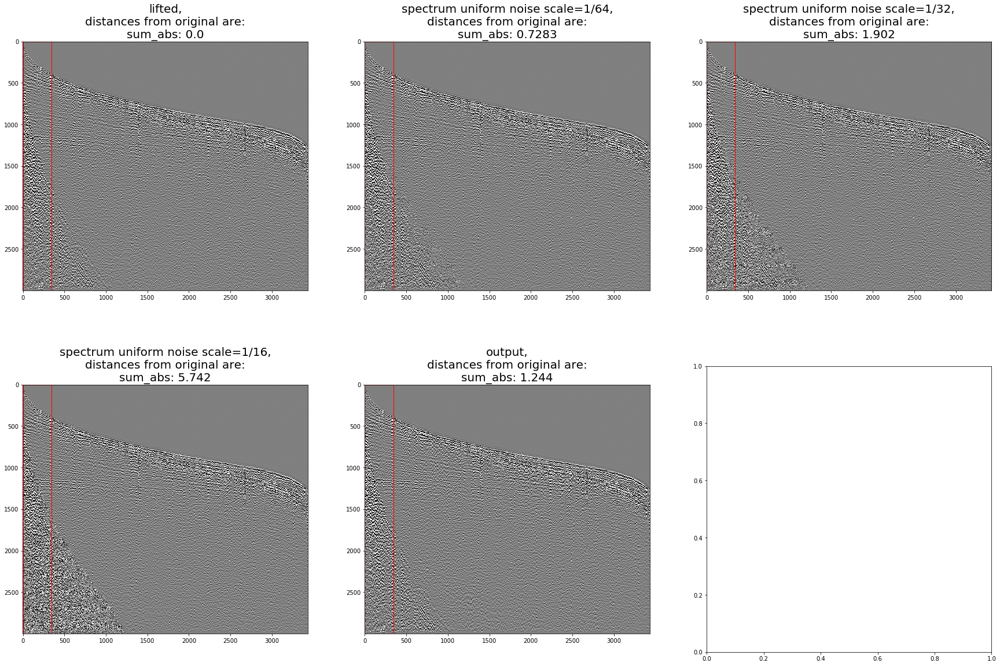

In [12]:
modifications = [(lift, "lifted")]
for scale in (64, 32, 16):  
    Zxx_n = Zxx + 1/scale * np.random.uniform(size=Zxx.shape)
    _, lift_restored = signal.istft(Zxx_n, **kwargs)
    lift_restored = lift * (1 - att) + lift_restored * att
    modifications.append((lift_restored, 'spectrum uniform noise scale=1/{}'.format(scale)))
    
modifications.append((out, "output"))

draw_modifications_dist(modifications, vmin=-cv, vmax=cv, figsize=(30, 20), n_cols=3)

# Сравнение выходов разных моделей

In [15]:
base_path = '' #'/notebooks/data/metrics_study_ibm_outputs/4_Metrix_QC/'
      
paths = dict(raw = '1_NA_qc_input_DN01.sgy',
            lift = '1_NA_qc_out_DN03.sgy',
            ibm_1 = '1_NA_qc_IBM_UNSUP.sgy',
            ibm_2 = '1_NA_qc_IBM_SUP.sgy',
            gpn = '1_NA_qc_GPN_1dUnet.sgy')

field_index = reduce(lambda x, y: x.merge(y), (FieldIndex(name=name, path=base_path+path, extra_headers=['offset']) for name, path in paths.items()))
batch = (Dataset(field_index, SeismicBatch).next_batch(6).load(fmt='segy', components=tuple(paths.keys())))
cv = get_cv([batch.raw[0]])

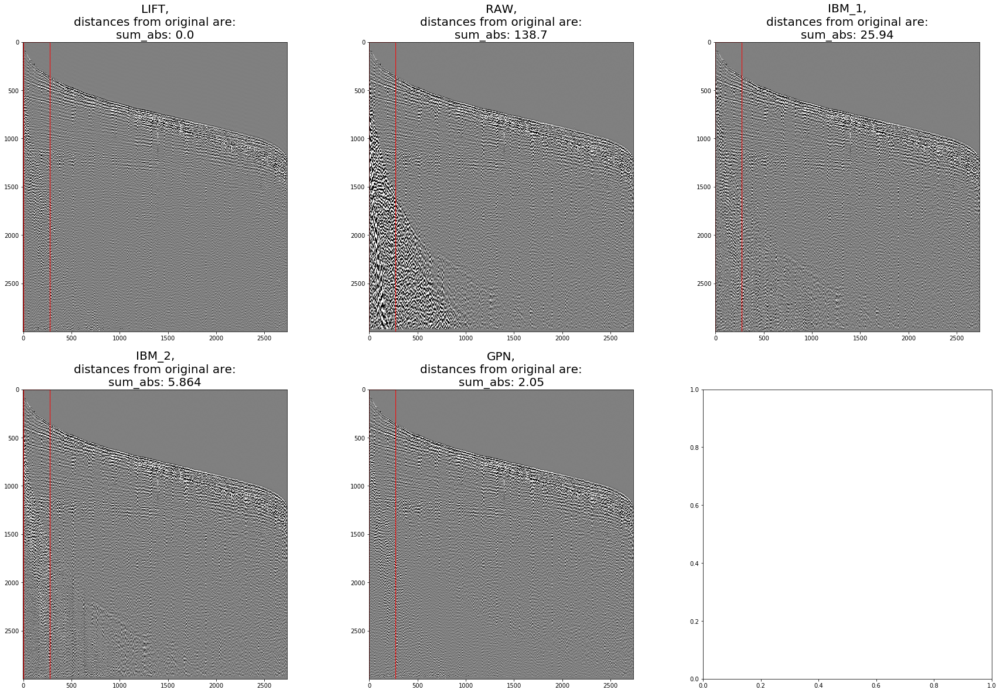

In [16]:
i=0
modifications = list(zip([batch.lift[i], batch.raw[i], batch.ibm_1[i], batch.ibm_2[i], batch.gpn[i]], ['LIFT', 'RAW', 'IBM_1', 'IBM_2', 'GPN']))

draw_modifications_dist(modifications, vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3)

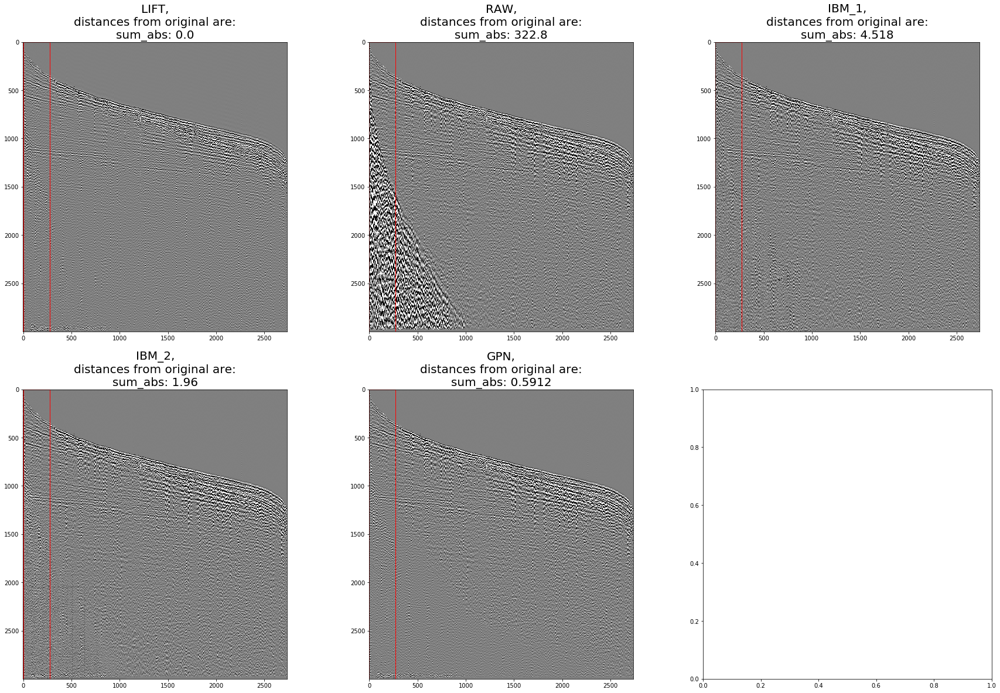

In [17]:
i=1
modifications = list(zip([batch.lift[i], batch.raw[i], batch.ibm_1[i], batch.ibm_2[i], batch.gpn[i]], ['LIFT', 'RAW', 'IBM_1', 'IBM_2', 'GPN']))

draw_modifications_dist(modifications, vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3)

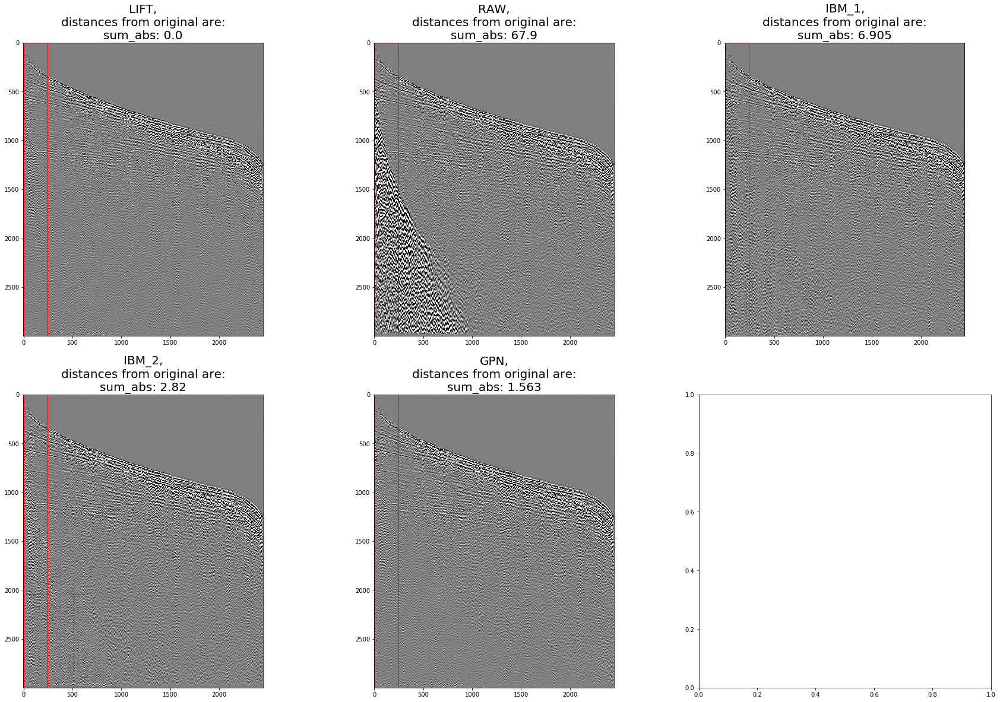

In [18]:
i=2
modifications = list(zip([batch.lift[i], batch.raw[i], batch.ibm_1[i], batch.ibm_2[i], batch.gpn[i]], ['LIFT', 'RAW', 'IBM_1', 'IBM_2', 'GPN']))

draw_modifications_dist(modifications, vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3)

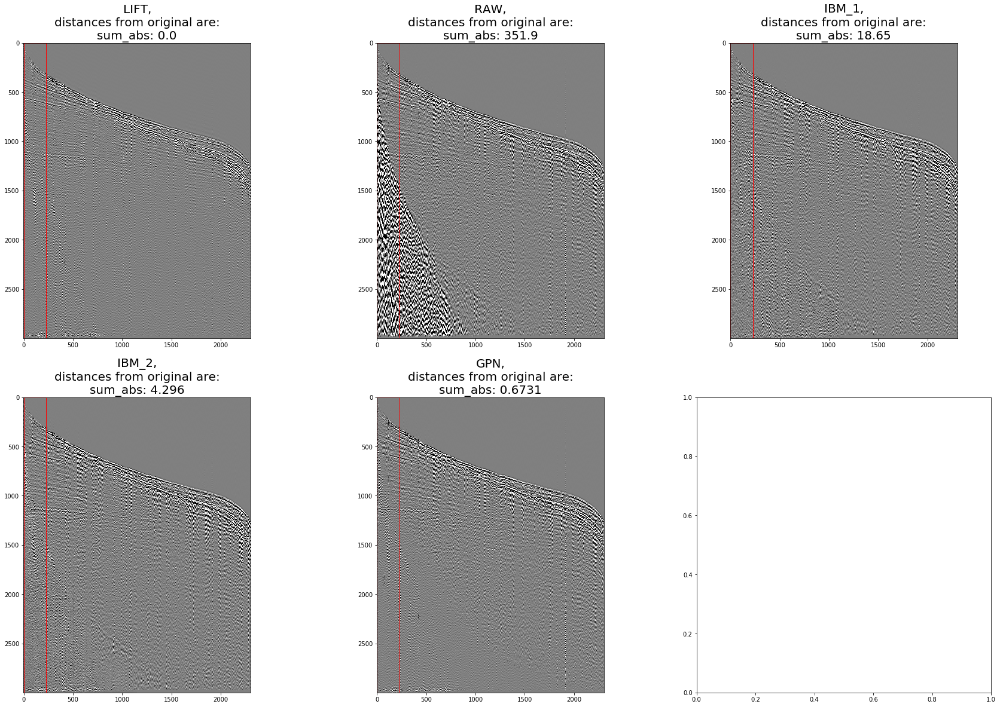

In [19]:
i=3
modifications = list(zip([batch.lift[i], batch.raw[i], batch.ibm_1[i], batch.ibm_2[i], batch.gpn[i]], ['LIFT', 'RAW', 'IBM_1', 'IBM_2', 'GPN']))

draw_modifications_dist(modifications, vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3)

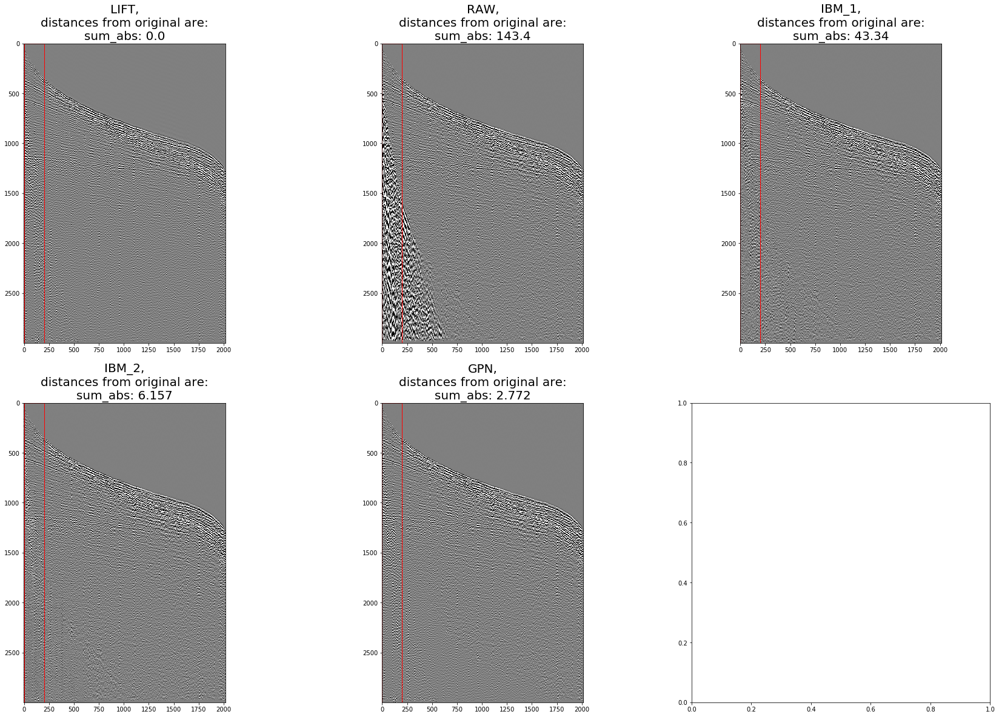

In [20]:
i=4
modifications = list(zip([batch.lift[i], batch.raw[i], batch.ibm_1[i], batch.ibm_2[i], batch.gpn[i]], ['LIFT', 'RAW', 'IBM_1', 'IBM_2', 'GPN']))

draw_modifications_dist(modifications, vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3)

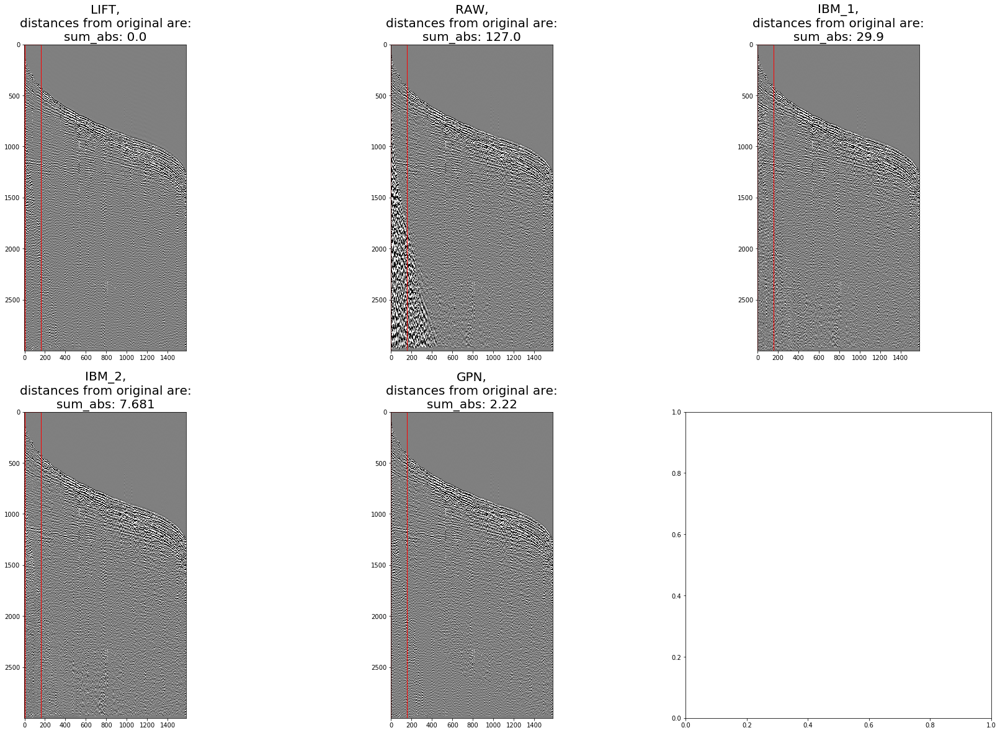

In [21]:
i=5
modifications = list(zip([batch.lift[i], batch.raw[i], batch.ibm_1[i], batch.ibm_2[i], batch.gpn[i]], ['LIFT', 'RAW', 'IBM_1', 'IBM_2', 'GPN']))

draw_modifications_dist(modifications, vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3)

## Локально испорченная сейсмограмма

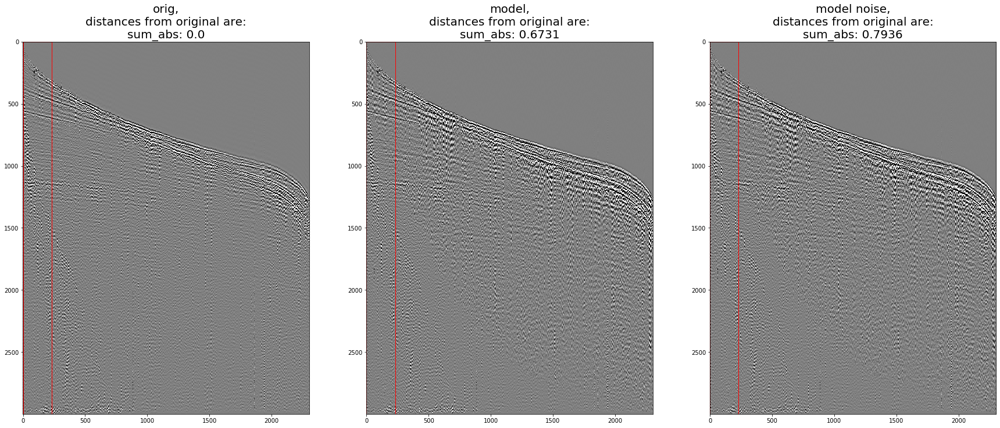

In [22]:
b = batch.gpn[3].copy()
noise = b.copy()

noise[0:100, 1100:1200] = noise[0:100, 1200:1300]

draw_modifications_dist([(batch.lift[3], "orig"), (b, "model"), (noise, "model noise")], vmin=-cv, vmax=cv, figsize=(30, 20), n_cols=3)